# Chapter 18 Notebook: Part 2

In [19]:
# Question #9
'''9. Use TF-Agents to train an agent that can achieve a superhuman level at
SpaceInvaders-v4 using any of the available algorithms.'''
import tensorflow as tf
import os
from tensorflow import keras
import numpy as np
import pandas as pd
import os 
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
from pathlib import Path
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 
from tf_agents.environments import suite_gym

env = suite_gym.load("SpaceInvaders-v4")
env

In [20]:
env.gym

<TimeLimit<OrderEnforcing<AtariEnv<SpaceInvaders-v4>>>>

In [21]:
env.seed(38) # Random seed
env.reset()

TimeStep(
{'discount': array(1., dtype=float32),
 'observation': array([[[ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0],
        ...,
        [ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0]],

       [[ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0],
        ...,
        [ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0]],

       [[ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0],
        ...,
        [ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0]],

       ...,

       [[80, 89, 22],
        [80, 89, 22],
        [80, 89, 22],
        ...,
        [80, 89, 22],
        [80, 89, 22],
        [80, 89, 22]],

       [[80, 89, 22],
        [80, 89, 22],
        [80, 89, 22],
        ...,
        [80, 89, 22],
        [80, 89, 22],
        [80, 89, 22]],

       [[80, 89, 22],
        [80, 89, 22],
        [80, 89, 22],
        ...,
        [80, 89, 22],
        [80, 89, 22],
        [80, 89, 22]]], dtype=uint8),
 'reward': array(0., dtype

In the above we get an observation in the environment. In this case the [80, 89, 22] observations represent the aliens at the top of the screen and then before that there are the obstacles in the way as well between the agent and the aliens. In this case we can also fire the weapon which is indicated by a step:

In [22]:
env.step(1) # fire

TimeStep(
{'discount': array(1., dtype=float32),
 'observation': array([[[ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0],
        ...,
        [ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0]],

       [[ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0],
        ...,
        [ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0]],

       [[ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0],
        ...,
        [ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0]],

       ...,

       [[80, 89, 22],
        [80, 89, 22],
        [80, 89, 22],
        ...,
        [80, 89, 22],
        [80, 89, 22],
        [80, 89, 22]],

       [[80, 89, 22],
        [80, 89, 22],
        [80, 89, 22],
        ...,
        [80, 89, 22],
        [80, 89, 22],
        [80, 89, 22]],

       [[80, 89, 22],
        [80, 89, 22],
        [80, 89, 22],
        ...,
        [80, 89, 22],
        [80, 89, 22],
        [80, 89, 22]]], dtype=uint8),
 'reward': array(0., dtype

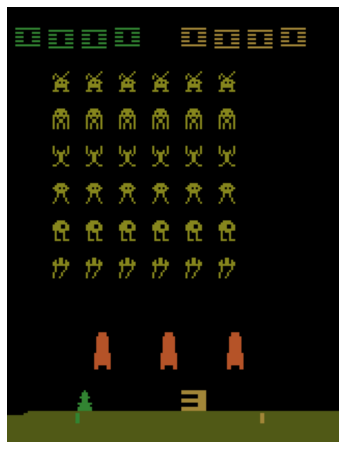

In [23]:
img = env.render(mode="rgb_array")

plt.figure(figsize=(6, 8))
plt.imshow(img)
plt.axis("off")
plt.show()

In [24]:
env.current_time_step() # New observations at current time step

TimeStep(
{'discount': array(1., dtype=float32),
 'observation': array([[[ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0],
        ...,
        [ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0]],

       [[ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0],
        ...,
        [ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0]],

       [[ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0],
        ...,
        [ 0,  0,  0],
        [ 0,  0,  0],
        [ 0,  0,  0]],

       ...,

       [[80, 89, 22],
        [80, 89, 22],
        [80, 89, 22],
        ...,
        [80, 89, 22],
        [80, 89, 22],
        [80, 89, 22]],

       [[80, 89, 22],
        [80, 89, 22],
        [80, 89, 22],
        ...,
        [80, 89, 22],
        [80, 89, 22],
        [80, 89, 22]],

       [[80, 89, 22],
        [80, 89, 22],
        [80, 89, 22],
        ...,
        [80, 89, 22],
        [80, 89, 22],
        [80, 89, 22]]], dtype=uint8),
 'reward': array(0., dtype

## Environment Specifications

In [25]:
env.observation_spec()

BoundedArraySpec(shape=(210, 160, 3), dtype=dtype('uint8'), name='observation', minimum=0, maximum=255)

In [26]:
env.action_spec()

BoundedArraySpec(shape=(), dtype=dtype('int64'), name='action', minimum=0, maximum=5)

In [27]:
env.time_step_spec()

TimeStep(
{'discount': BoundedArraySpec(shape=(), dtype=dtype('float32'), name='discount', minimum=0.0, maximum=1.0),
 'observation': BoundedArraySpec(shape=(210, 160, 3), dtype=dtype('uint8'), name='observation', minimum=0, maximum=255),
 'reward': ArraySpec(shape=(), dtype=dtype('float32'), name='reward'),
 'step_type': ArraySpec(shape=(), dtype=dtype('int32'), name='step_type')})

## Environment Wrappers

In [28]:
# Wrapping TF-Agent environments inside of TF-Agent Wrappers
from tf_agents.environments.wrappers import ActionRepeat

repeating_env = ActionRepeat(env, times=4)
repeating_env

In [29]:
repeating_env.unwrapped

The suite_gym.load() function can create an env and wrap it for you, both with TF-Agents environment wrappers and Gym environment wrappers (the latter are applied first).

In [30]:
from functools import partial
from gym.wrappers import TimeLimit

limited_repeating_env = suite_gym.load(
    "SpaceInvaders-v4",
    gym_env_wrappers=[partial(TimeLimit, max_episode_steps=10000)],
    env_wrappers=[partial(ActionRepeat, times=4)],
)

In [31]:
limited_repeating_env

In [32]:
limited_repeating_env.unwrapped

In Space Invaders, the player's laser cannoty blink for a few seconds then the game start automatically. So instead, we will create a class from preprocessign the start of each round in space invaders. To speed up training considerably, we create and use a subclass of the Atari_Preprocessing wrapper called AtariPreprocessing:

In [33]:
from tf_agents.environments import suite_atari
from tf_agents.environments.atari_preprocessing import AtariPreprocessing
from tf_agents.environments.atari_wrappers import FrameStack4

max_episode_steps = 27000 # == 108k ALE frames since 1 step = 4 frames
environment_name = "SpaceInvaders-v4"

class AtariPreprocessingWithSkipStart(AtariPreprocessing):
    def skip_frames(self, num_skip):
        for _ in range(num_skip):
            super().step(0) # NOOP for num_skip steps
    def reset(self, **kwargs):
        obs = super().reset(**kwargs)
        self.skip_frames(40)
        return obs
    def step(self, action):
        lives_before_action = self.ale.lives()
        obs, rewards, done, info = super().step(action)
        if self.ale.lives() < lives_before_action and not done:
            self.skip_frames(40)
        return obs, rewards, done, info
    
env = suite_atari.load( environment_name,
                        max_episode_steps = max_episode_steps,
                        gym_env_wrappers = [ AtariPreprocessingWithSkipStart, 
                                             FrameStack4]
                      )  

In [35]:
# Now to see results of a few steps
env.seed(42)
env.reset()

for _ in range(4):
    time_step = env.step(3)


The agent only gets to see every n frames of the game (by default n = 4) OR 4 frames per step

In [36]:
env.current_time_step().observation.shape

(84, 84, 4)

In [39]:
def plot_observation(obs):
    # Since there are only 3 color channels, you cannot display 4 frames
    # with one primary color per frame. So this code computes the delta between
    # the current frame and the mean of the other frames, and it adds this delta
    # to the red and blue channels to get a pink color for the current frame.
    obs = obs.astype(np.float32)
    img = obs[..., :3]
    current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
    img[..., 0] += current_frame_delta
    img[..., 2] += current_frame_delta
    img = np.clip(img / 150, 0, 1)
    plt.imshow(img)
    plt.axis("off")

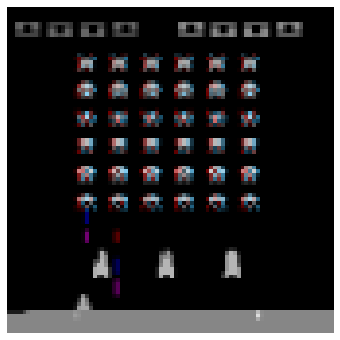

In [40]:
plt.figure(figsize=(6, 6))
plot_observation(time_step.observation)
plt.show()

Lastly, we can wrap the environment inside a TFPyEnvironment ( Convert the Python environment to a TF environment ):

In [38]:
from tf_agents.environments.tf_py_environment import TFPyEnvironment
 
tf_env = TFPyEnvironment( env )

## Creating the DQN

Create a small class to normalize the observations. Images are stored using bytes from 0 to 255 to use less RAM, but we want to pass floats from 0.0 to 1.0 to the neural network:

Create the Q-Network:

In [41]:
from tf_agents.networks.q_network import QNetwork

preprocessing_layer = keras.layers.Lambda(
                          lambda obs: tf.cast(obs, np.float32) / 255.)
conv_layer_params=[(32, (8, 8), 4), (64, (4, 4), 2), (64, (3, 3), 1)]
fc_layer_params=[512]

q_net = QNetwork(
    tf_env.observation_spec(),
    tf_env.action_spec(),
    preprocessing_layers=preprocessing_layer,
    conv_layer_params=conv_layer_params,
    fc_layer_params=fc_layer_params)

Create the DQN Agent:

In [42]:
from tf_agents.agents.dqn.dqn_agent import DqnAgent

train_step = tf.Variable(0)
update_period = 4 # run a training step every 4 collect steps
optimizer = keras.optimizers.RMSprop(learning_rate=2.5e-4, rho=0.95, momentum=0.0,
                                     epsilon=0.00001, centered=True)
epsilon_fn = keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=1.0, # initial ε
    decay_steps=250000 // update_period, # <=> 1,000,000 ALE frames
    end_learning_rate=0.01) # final ε
agent = DqnAgent(tf_env.time_step_spec(),
                 tf_env.action_spec(),
                 q_network=q_net,
                 optimizer=optimizer,
                 target_update_period=2000, # <=> 32,000 ALE frames
                 td_errors_loss_fn=keras.losses.Huber(reduction="none"),
                 gamma=0.99, # discount factor
                 train_step_counter=train_step,
                 epsilon_greedy=lambda: epsilon_fn(train_step))
agent.initialize()

Create the replay buffer:

In [43]:
from tf_agents.replay_buffers import tf_uniform_replay_buffer

replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer(
    data_spec=agent.collect_data_spec,
    batch_size=tf_env.batch_size,
    max_length=1000000)

replay_buffer_observer = replay_buffer.add_batch

Create a simple custom observer that counts and displays the number of times it is called (except when it is passed a trajectory that represents the boundary between two episodes, as this does not count as a step):

In [44]:
class ShowProgress:
    def __init__(self, total):
        self.counter = 0
        self.total = total
    def __call__(self, trajectory):
        if not trajectory.is_boundary():
            self.counter += 1
        if self.counter % 100 == 0:
            print("\r{}/{}".format(self.counter, self.total), end="")

Let's add some training metrics:

In [45]:
from tf_agents.metrics import tf_metrics

train_metrics = [
    tf_metrics.NumberOfEpisodes(),
    tf_metrics.EnvironmentSteps(),
    tf_metrics.AverageReturnMetric(),
    tf_metrics.AverageEpisodeLengthMetric(),
]

In [46]:
train_metrics[0].result()

<tf.Tensor: shape=(), dtype=int64, numpy=0>

In [47]:
from tf_agents.eval.metric_utils import log_metrics
import logging
logging.getLogger().setLevel(logging.INFO)
log_metrics(train_metrics)

INFO:absl: 
		 NumberOfEpisodes = 0
		 EnvironmentSteps = 0
		 AverageReturn = 0.0
		 AverageEpisodeLength = 0.0


Create the collect driver:

In [48]:
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver

collect_driver = DynamicStepDriver(
    tf_env,
    agent.collect_policy,
    observers=[replay_buffer_observer] + train_metrics,
    num_steps=update_period) # collect 4 steps for each training iteration

Collect the initial experiences, before training:

In [49]:
from tf_agents.policies.random_tf_policy import RandomTFPolicy

initial_collect_policy = RandomTFPolicy(tf_env.time_step_spec(),
                                        tf_env.action_spec())
init_driver = DynamicStepDriver(
    tf_env,
    initial_collect_policy,
    observers=[replay_buffer.add_batch, ShowProgress(20000)],
    num_steps=20000) # <=> 80,000 ALE frames
final_time_step, final_policy_state = init_driver.run()

20000/20000

Let's sample 2 sub-episodes, with 3 time steps each and display them:

In [50]:
tf.random.set_seed(16) # chosen to show an example of trajectory at the end of an episode

trajectories, buffer_info = next(iter(replay_buffer.as_dataset(
    sample_batch_size=2,
    num_steps=3,
    single_deterministic_pass=False)))

Instructions for updating:
Use `as_dataset(..., single_deterministic_pass=False) instead.


Instructions for updating:
Use `as_dataset(..., single_deterministic_pass=False) instead.


In [51]:
trajectories._fields

('step_type',
 'observation',
 'action',
 'policy_info',
 'next_step_type',
 'reward',
 'discount')

In [52]:
trajectories.observation.shape

TensorShape([2, 3, 84, 84, 4])

In [53]:
from tf_agents.trajectories.trajectory import to_transition

time_steps, action_steps, next_time_steps = to_transition(trajectories)
time_steps.observation.shape

TensorShape([2, 2, 84, 84, 4])

In [54]:
trajectories.step_type.numpy()

array([[1, 1, 1],
       [1, 1, 1]])

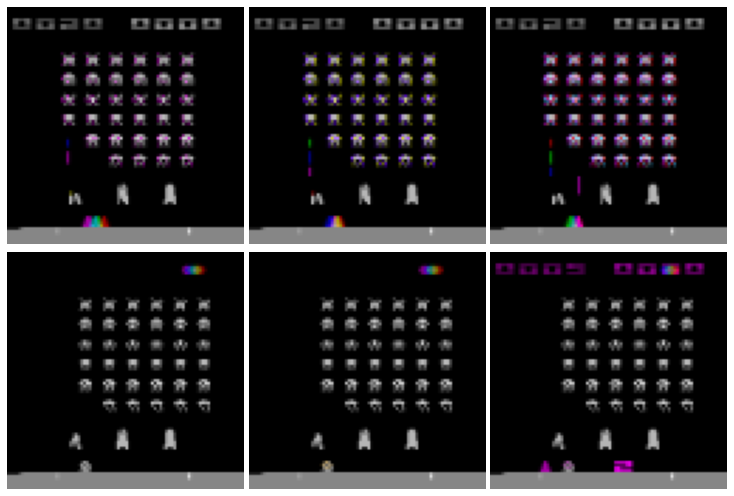

In [55]:
plt.figure(figsize=(10, 6.8))
for row in range(2):
    for col in range(3):
        plt.subplot(2, 3, row * 3 + col + 1)
        plot_observation(trajectories.observation[row, col].numpy())
plt.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0, wspace=0.02)
plt.show()

In [71]:
# Creating the dataset
dataset = replay_buffer.as_dataset(
    sample_batch_size=128,
    num_steps=2,
    num_parallel_calls=3).prefetch(3)

Convert the main functions to TF Functions for better performance:

In [72]:
from tf_agents.utils.common import function

collect_driver.run = function(collect_driver.run)
agent.train = function(agent.train)

In [73]:
# Main Loop
def train_agent(n_iterations):
    time_step = None
    policy_state = agent.collect_policy.get_initial_state(tf_env.batch_size)
    iterator = iter(dataset)
    for iteration in range(n_iterations):
        time_step, policy_state = collect_driver.run(time_step, policy_state)
        trajectories, buffer_info = next(iterator)
        train_loss = agent.train(trajectories)
        print("\r{} loss:{:.5f}".format(
            iteration, train_loss.loss.numpy()), end="")
        if iteration % 1000 == 0:
            log_metrics(train_metrics)

In [74]:
# Train for 50,000 steps
train_agent(n_iterations=100000)

INFO:absl: 
		 NumberOfEpisodes = 1457
		 EnvironmentSteps = 239988
		 AverageReturn = 180.5
		 AverageEpisodeLength = 181.6999969482422


999 loss:4.93744

INFO:absl: 
		 NumberOfEpisodes = 1475
		 EnvironmentSteps = 243988
		 AverageReturn = 218.5
		 AverageEpisodeLength = 240.1999969482422


1998 loss:2.42532

INFO:absl: 
		 NumberOfEpisodes = 1484
		 EnvironmentSteps = 247988
		 AverageReturn = 183.5
		 AverageEpisodeLength = 420.5


3000 loss:3.40110

INFO:absl: 
		 NumberOfEpisodes = 1503
		 EnvironmentSteps = 251988
		 AverageReturn = 215.5
		 AverageEpisodeLength = 214.10000610351562


3999 loss:2.98606

INFO:absl: 
		 NumberOfEpisodes = 1525
		 EnvironmentSteps = 255988
		 AverageReturn = 155.5
		 AverageEpisodeLength = 197.89999389648438


4999 loss:2.87870

INFO:absl: 
		 NumberOfEpisodes = 1541
		 EnvironmentSteps = 259988
		 AverageReturn = 152.5
		 AverageEpisodeLength = 259.79998779296875


5997 loss:3.25490

INFO:absl: 
		 NumberOfEpisodes = 1555
		 EnvironmentSteps = 263988
		 AverageReturn = 195.5
		 AverageEpisodeLength = 249.60000610351562


7000 loss:2.38160

INFO:absl: 
		 NumberOfEpisodes = 1573
		 EnvironmentSteps = 267988
		 AverageReturn = 209.0
		 AverageEpisodeLength = 242.89999389648438


7999 loss:2.28091

INFO:absl: 
		 NumberOfEpisodes = 1593
		 EnvironmentSteps = 271988
		 AverageReturn = 182.0
		 AverageEpisodeLength = 167.60000610351562


8998 loss:2.84497

INFO:absl: 
		 NumberOfEpisodes = 1611
		 EnvironmentSteps = 275988
		 AverageReturn = 190.5
		 AverageEpisodeLength = 150.60000610351562


9998 loss:3.33719

INFO:absl: 
		 NumberOfEpisodes = 1630
		 EnvironmentSteps = 279988
		 AverageReturn = 162.5
		 AverageEpisodeLength = 240.10000610351562


11000 loss:2.17668

INFO:absl: 
		 NumberOfEpisodes = 1647
		 EnvironmentSteps = 283988
		 AverageReturn = 203.0
		 AverageEpisodeLength = 172.39999389648438


11998 loss:1.72746

INFO:absl: 
		 NumberOfEpisodes = 1669
		 EnvironmentSteps = 287988
		 AverageReturn = 198.0
		 AverageEpisodeLength = 158.10000610351562


12999 loss:1.94951

INFO:absl: 
		 NumberOfEpisodes = 1685
		 EnvironmentSteps = 291988
		 AverageReturn = 172.0
		 AverageEpisodeLength = 238.5


13999 loss:2.62372

INFO:absl: 
		 NumberOfEpisodes = 1698
		 EnvironmentSteps = 295988
		 AverageReturn = 208.0
		 AverageEpisodeLength = 301.29998779296875


14999 loss:2.87194

INFO:absl: 
		 NumberOfEpisodes = 1715
		 EnvironmentSteps = 299988
		 AverageReturn = 237.0
		 AverageEpisodeLength = 190.8000030517578


15999 loss:3.09865

INFO:absl: 
		 NumberOfEpisodes = 1733
		 EnvironmentSteps = 303988
		 AverageReturn = 200.5
		 AverageEpisodeLength = 135.10000610351562


16999 loss:2.70604

INFO:absl: 
		 NumberOfEpisodes = 1747
		 EnvironmentSteps = 307988
		 AverageReturn = 299.5
		 AverageEpisodeLength = 312.5


17999 loss:2.13103

INFO:absl: 
		 NumberOfEpisodes = 1761
		 EnvironmentSteps = 311988
		 AverageReturn = 250.5
		 AverageEpisodeLength = 271.6000061035156


18999 loss:2.83252

INFO:absl: 
		 NumberOfEpisodes = 1775
		 EnvironmentSteps = 315988
		 AverageReturn = 289.0
		 AverageEpisodeLength = 337.1000061035156


20000 loss:3.55777

INFO:absl: 
		 NumberOfEpisodes = 1790
		 EnvironmentSteps = 319988
		 AverageReturn = 268.5
		 AverageEpisodeLength = 250.60000610351562


20998 loss:3.84270

INFO:absl: 
		 NumberOfEpisodes = 1808
		 EnvironmentSteps = 323988
		 AverageReturn = 276.5
		 AverageEpisodeLength = 228.3000030517578


21997 loss:3.06589

INFO:absl: 
		 NumberOfEpisodes = 1824
		 EnvironmentSteps = 327988
		 AverageReturn = 259.0
		 AverageEpisodeLength = 219.1999969482422


23000 loss:3.11607

INFO:absl: 
		 NumberOfEpisodes = 1838
		 EnvironmentSteps = 331988
		 AverageReturn = 263.0
		 AverageEpisodeLength = 252.89999389648438


23998 loss:3.82894

INFO:absl: 
		 NumberOfEpisodes = 1857
		 EnvironmentSteps = 335988
		 AverageReturn = 288.5
		 AverageEpisodeLength = 282.20001220703125


24999 loss:2.44075

INFO:absl: 
		 NumberOfEpisodes = 1871
		 EnvironmentSteps = 339988
		 AverageReturn = 278.0
		 AverageEpisodeLength = 223.60000610351562


25999 loss:4.28631

INFO:absl: 
		 NumberOfEpisodes = 1885
		 EnvironmentSteps = 343988
		 AverageReturn = 242.0
		 AverageEpisodeLength = 262.29998779296875


26999 loss:2.88319

INFO:absl: 
		 NumberOfEpisodes = 1904
		 EnvironmentSteps = 347988
		 AverageReturn = 184.5
		 AverageEpisodeLength = 195.8000030517578


27998 loss:6.00909

INFO:absl: 
		 NumberOfEpisodes = 1916
		 EnvironmentSteps = 351988
		 AverageReturn = 302.5
		 AverageEpisodeLength = 335.20001220703125


28998 loss:2.96116

INFO:absl: 
		 NumberOfEpisodes = 1930
		 EnvironmentSteps = 355988
		 AverageReturn = 296.0
		 AverageEpisodeLength = 298.5


29999 loss:2.98624

INFO:absl: 
		 NumberOfEpisodes = 1945
		 EnvironmentSteps = 359988
		 AverageReturn = 177.5
		 AverageEpisodeLength = 199.39999389648438


30999 loss:3.40525

INFO:absl: 
		 NumberOfEpisodes = 1962
		 EnvironmentSteps = 363988
		 AverageReturn = 284.0
		 AverageEpisodeLength = 227.60000610351562


31998 loss:3.41057

INFO:absl: 
		 NumberOfEpisodes = 1977
		 EnvironmentSteps = 367988
		 AverageReturn = 272.0
		 AverageEpisodeLength = 302.3999938964844


32998 loss:3.95535

INFO:absl: 
		 NumberOfEpisodes = 1995
		 EnvironmentSteps = 371988
		 AverageReturn = 255.0
		 AverageEpisodeLength = 206.60000610351562


33999 loss:3.51528

INFO:absl: 
		 NumberOfEpisodes = 2009
		 EnvironmentSteps = 375988
		 AverageReturn = 285.5
		 AverageEpisodeLength = 231.60000610351562


34998 loss:5.58904

INFO:absl: 
		 NumberOfEpisodes = 2028
		 EnvironmentSteps = 379988
		 AverageReturn = 316.0
		 AverageEpisodeLength = 215.3000030517578


35998 loss:4.38703

INFO:absl: 
		 NumberOfEpisodes = 2047
		 EnvironmentSteps = 383988
		 AverageReturn = 191.0
		 AverageEpisodeLength = 175.1999969482422


36999 loss:3.29792

INFO:absl: 
		 NumberOfEpisodes = 2064
		 EnvironmentSteps = 387988
		 AverageReturn = 285.5
		 AverageEpisodeLength = 256.29998779296875


37998 loss:3.45903

INFO:absl: 
		 NumberOfEpisodes = 2080
		 EnvironmentSteps = 391988
		 AverageReturn = 336.5
		 AverageEpisodeLength = 258.3999938964844


38997 loss:3.86946

INFO:absl: 
		 NumberOfEpisodes = 2095
		 EnvironmentSteps = 395988
		 AverageReturn = 213.0
		 AverageEpisodeLength = 309.20001220703125


40000 loss:5.10871

INFO:absl: 
		 NumberOfEpisodes = 2109
		 EnvironmentSteps = 399988
		 AverageReturn = 234.5
		 AverageEpisodeLength = 244.5


40998 loss:4.07234

INFO:absl: 
		 NumberOfEpisodes = 2124
		 EnvironmentSteps = 403988
		 AverageReturn = 254.0
		 AverageEpisodeLength = 218.39999389648438


41999 loss:3.50544

INFO:absl: 
		 NumberOfEpisodes = 2144
		 EnvironmentSteps = 407988
		 AverageReturn = 144.0
		 AverageEpisodeLength = 196.60000610351562


43000 loss:2.69373

INFO:absl: 
		 NumberOfEpisodes = 2162
		 EnvironmentSteps = 411988
		 AverageReturn = 209.5
		 AverageEpisodeLength = 150.6999969482422


43998 loss:5.02258

INFO:absl: 
		 NumberOfEpisodes = 2174
		 EnvironmentSteps = 415988
		 AverageReturn = 294.0
		 AverageEpisodeLength = 266.3999938964844


44998 loss:2.97305

INFO:absl: 
		 NumberOfEpisodes = 2187
		 EnvironmentSteps = 419988
		 AverageReturn = 238.5
		 AverageEpisodeLength = 242.10000610351562


45999 loss:3.40806

INFO:absl: 
		 NumberOfEpisodes = 2202
		 EnvironmentSteps = 423988
		 AverageReturn = 345.5
		 AverageEpisodeLength = 227.3000030517578


47000 loss:2.97707

INFO:absl: 
		 NumberOfEpisodes = 2220
		 EnvironmentSteps = 427988
		 AverageReturn = 210.0
		 AverageEpisodeLength = 196.60000610351562


47999 loss:3.52488

INFO:absl: 
		 NumberOfEpisodes = 2233
		 EnvironmentSteps = 431988
		 AverageReturn = 271.5
		 AverageEpisodeLength = 310.0


48998 loss:4.36375

INFO:absl: 
		 NumberOfEpisodes = 2251
		 EnvironmentSteps = 435988
		 AverageReturn = 267.0
		 AverageEpisodeLength = 198.8000030517578


49998 loss:3.40751

INFO:absl: 
		 NumberOfEpisodes = 2266
		 EnvironmentSteps = 439988
		 AverageReturn = 197.5
		 AverageEpisodeLength = 272.29998779296875


51000 loss:3.26622

INFO:absl: 
		 NumberOfEpisodes = 2286
		 EnvironmentSteps = 443988
		 AverageReturn = 186.5
		 AverageEpisodeLength = 148.10000610351562


51998 loss:3.90503

INFO:absl: 
		 NumberOfEpisodes = 2304
		 EnvironmentSteps = 447988
		 AverageReturn = 250.5
		 AverageEpisodeLength = 232.0


52999 loss:4.17149

INFO:absl: 
		 NumberOfEpisodes = 2320
		 EnvironmentSteps = 451988
		 AverageReturn = 226.5
		 AverageEpisodeLength = 294.29998779296875


53999 loss:3.45809

INFO:absl: 
		 NumberOfEpisodes = 2337
		 EnvironmentSteps = 455988
		 AverageReturn = 242.5
		 AverageEpisodeLength = 228.5


54999 loss:3.80945

INFO:absl: 
		 NumberOfEpisodes = 2347
		 EnvironmentSteps = 459988
		 AverageReturn = 319.5
		 AverageEpisodeLength = 391.5


55998 loss:4.83354

INFO:absl: 
		 NumberOfEpisodes = 2364
		 EnvironmentSteps = 463988
		 AverageReturn = 223.0
		 AverageEpisodeLength = 192.0


56999 loss:3.87099

INFO:absl: 
		 NumberOfEpisodes = 2382
		 EnvironmentSteps = 467988
		 AverageReturn = 174.0
		 AverageEpisodeLength = 127.9000015258789


57997 loss:5.56769

INFO:absl: 
		 NumberOfEpisodes = 2400
		 EnvironmentSteps = 471988
		 AverageReturn = 255.5
		 AverageEpisodeLength = 194.8000030517578


58999 loss:2.86600

INFO:absl: 
		 NumberOfEpisodes = 2417
		 EnvironmentSteps = 475988
		 AverageReturn = 237.0
		 AverageEpisodeLength = 252.3000030517578


59999 loss:3.65444

INFO:absl: 
		 NumberOfEpisodes = 2438
		 EnvironmentSteps = 479988
		 AverageReturn = 135.5
		 AverageEpisodeLength = 92.0


61000 loss:4.35228

INFO:absl: 
		 NumberOfEpisodes = 2459
		 EnvironmentSteps = 483988
		 AverageReturn = 238.5
		 AverageEpisodeLength = 147.3000030517578


61997 loss:5.14781

INFO:absl: 
		 NumberOfEpisodes = 2483
		 EnvironmentSteps = 487988
		 AverageReturn = 227.0
		 AverageEpisodeLength = 180.10000610351562


62999 loss:4.15354

INFO:absl: 
		 NumberOfEpisodes = 2508
		 EnvironmentSteps = 491988
		 AverageReturn = 268.0
		 AverageEpisodeLength = 165.6999969482422


64000 loss:4.27757

INFO:absl: 
		 NumberOfEpisodes = 2528
		 EnvironmentSteps = 495988
		 AverageReturn = 286.5
		 AverageEpisodeLength = 190.8000030517578


64999 loss:2.82467

INFO:absl: 
		 NumberOfEpisodes = 2549
		 EnvironmentSteps = 499988
		 AverageReturn = 321.0
		 AverageEpisodeLength = 240.3000030517578


65998 loss:3.78964

INFO:absl: 
		 NumberOfEpisodes = 2563
		 EnvironmentSteps = 503988
		 AverageReturn = 284.0
		 AverageEpisodeLength = 258.79998779296875


66999 loss:4.41141

INFO:absl: 
		 NumberOfEpisodes = 2584
		 EnvironmentSteps = 507988
		 AverageReturn = 202.5
		 AverageEpisodeLength = 180.10000610351562


67999 loss:3.87348

INFO:absl: 
		 NumberOfEpisodes = 2596
		 EnvironmentSteps = 511988
		 AverageReturn = 315.0
		 AverageEpisodeLength = 369.20001220703125


69000 loss:3.11072

INFO:absl: 
		 NumberOfEpisodes = 2615
		 EnvironmentSteps = 515988
		 AverageReturn = 317.0
		 AverageEpisodeLength = 209.39999389648438


70000 loss:3.05886

INFO:absl: 
		 NumberOfEpisodes = 2633
		 EnvironmentSteps = 519988
		 AverageReturn = 336.5
		 AverageEpisodeLength = 221.8000030517578


70998 loss:4.80989

INFO:absl: 
		 NumberOfEpisodes = 2659
		 EnvironmentSteps = 523988
		 AverageReturn = 131.5
		 AverageEpisodeLength = 108.19999694824219


72000 loss:4.22492

INFO:absl: 
		 NumberOfEpisodes = 2678
		 EnvironmentSteps = 527988
		 AverageReturn = 245.5
		 AverageEpisodeLength = 253.0


72998 loss:4.36927

INFO:absl: 
		 NumberOfEpisodes = 2702
		 EnvironmentSteps = 531988
		 AverageReturn = 291.0
		 AverageEpisodeLength = 179.60000610351562


74000 loss:4.33155

INFO:absl: 
		 NumberOfEpisodes = 2725
		 EnvironmentSteps = 535988
		 AverageReturn = 189.5
		 AverageEpisodeLength = 160.3000030517578


75000 loss:6.47060

INFO:absl: 
		 NumberOfEpisodes = 2744
		 EnvironmentSteps = 539988
		 AverageReturn = 315.5
		 AverageEpisodeLength = 182.6999969482422


75999 loss:3.44697

INFO:absl: 
		 NumberOfEpisodes = 2761
		 EnvironmentSteps = 543988
		 AverageReturn = 142.0
		 AverageEpisodeLength = 195.60000610351562


76998 loss:8.28039

INFO:absl: 
		 NumberOfEpisodes = 2779
		 EnvironmentSteps = 547988
		 AverageReturn = 235.0
		 AverageEpisodeLength = 246.3000030517578


77999 loss:4.64424

INFO:absl: 
		 NumberOfEpisodes = 2796
		 EnvironmentSteps = 551988
		 AverageReturn = 287.0
		 AverageEpisodeLength = 246.6999969482422


79000 loss:3.97357

INFO:absl: 
		 NumberOfEpisodes = 2809
		 EnvironmentSteps = 555988
		 AverageReturn = 330.5
		 AverageEpisodeLength = 294.6000061035156


80000 loss:3.11512

INFO:absl: 
		 NumberOfEpisodes = 2825
		 EnvironmentSteps = 559988
		 AverageReturn = 371.0
		 AverageEpisodeLength = 292.6000061035156


80999 loss:3.82059

INFO:absl: 
		 NumberOfEpisodes = 2841
		 EnvironmentSteps = 563988
		 AverageReturn = 349.5
		 AverageEpisodeLength = 234.0


81999 loss:4.37309

INFO:absl: 
		 NumberOfEpisodes = 2855
		 EnvironmentSteps = 567988
		 AverageReturn = 370.0
		 AverageEpisodeLength = 281.5


82999 loss:5.55399

INFO:absl: 
		 NumberOfEpisodes = 2869
		 EnvironmentSteps = 571988
		 AverageReturn = 265.0
		 AverageEpisodeLength = 247.5


83999 loss:3.75908

INFO:absl: 
		 NumberOfEpisodes = 2883
		 EnvironmentSteps = 575988
		 AverageReturn = 268.0
		 AverageEpisodeLength = 276.6000061035156


85000 loss:5.49596

INFO:absl: 
		 NumberOfEpisodes = 2899
		 EnvironmentSteps = 579988
		 AverageReturn = 278.0
		 AverageEpisodeLength = 309.70001220703125


85999 loss:4.57194

INFO:absl: 
		 NumberOfEpisodes = 2918
		 EnvironmentSteps = 583988
		 AverageReturn = 347.0
		 AverageEpisodeLength = 224.5


86999 loss:5.46082

INFO:absl: 
		 NumberOfEpisodes = 2929
		 EnvironmentSteps = 587988
		 AverageReturn = 334.0
		 AverageEpisodeLength = 335.3999938964844


87998 loss:5.97484

INFO:absl: 
		 NumberOfEpisodes = 2943
		 EnvironmentSteps = 591988
		 AverageReturn = 250.0
		 AverageEpisodeLength = 251.10000610351562


89000 loss:4.21488

INFO:absl: 
		 NumberOfEpisodes = 2957
		 EnvironmentSteps = 595988
		 AverageReturn = 295.5
		 AverageEpisodeLength = 272.70001220703125


89999 loss:2.702063

INFO:absl: 
		 NumberOfEpisodes = 2972
		 EnvironmentSteps = 599988
		 AverageReturn = 371.0
		 AverageEpisodeLength = 258.79998779296875


90998 loss:4.13513

INFO:absl: 
		 NumberOfEpisodes = 2987
		 EnvironmentSteps = 603988
		 AverageReturn = 263.0
		 AverageEpisodeLength = 265.29998779296875


91998 loss:6.48080

INFO:absl: 
		 NumberOfEpisodes = 3003
		 EnvironmentSteps = 607988
		 AverageReturn = 252.5
		 AverageEpisodeLength = 230.39999389648438


92999 loss:3.25500

INFO:absl: 
		 NumberOfEpisodes = 3022
		 EnvironmentSteps = 611988
		 AverageReturn = 315.5
		 AverageEpisodeLength = 241.5


93998 loss:4.10955

INFO:absl: 
		 NumberOfEpisodes = 3038
		 EnvironmentSteps = 615988
		 AverageReturn = 174.0
		 AverageEpisodeLength = 185.60000610351562


95000 loss:4.79006

INFO:absl: 
		 NumberOfEpisodes = 3048
		 EnvironmentSteps = 619988
		 AverageReturn = 257.0
		 AverageEpisodeLength = 405.1000061035156


96000 loss:4.90078

INFO:absl: 
		 NumberOfEpisodes = 3063
		 EnvironmentSteps = 623988
		 AverageReturn = 270.5
		 AverageEpisodeLength = 261.70001220703125


96998 loss:5.96890

INFO:absl: 
		 NumberOfEpisodes = 3077
		 EnvironmentSteps = 627988
		 AverageReturn = 270.5
		 AverageEpisodeLength = 237.6999969482422


97998 loss:3.79582

INFO:absl: 
		 NumberOfEpisodes = 3096
		 EnvironmentSteps = 631988
		 AverageReturn = 318.5
		 AverageEpisodeLength = 278.79998779296875


98999 loss:3.39352

INFO:absl: 
		 NumberOfEpisodes = 3106
		 EnvironmentSteps = 635988
		 AverageReturn = 327.5
		 AverageEpisodeLength = 293.20001220703125


99999 loss:3.43449

In [75]:
import matplotlib.animation as animation
import matplotlib as mpl
mpl.rc('animation', html='jshtml')
 
def update_scene( num, frames, patch ):
    patch.set_data( frames[num] )
    return patch,
 
def plot_animation( frames, repeat=False, interval=40 ):
    fig = plt.figure()
    patch = plt.imshow( frames[0] ) # img
    plt.axis( 'off' )
 
    
    anim = animation.FuncAnimation(
            fig,         # figure
            func=update_scene, # The function to call at each frame. 
            fargs=(frames, patch), # Additional arguments to pass to each call to func.
            frames = len(frames),  # iterable, int, generator function, or None, optional : Source of data to pass func and each frame of the animation
            repeat=repeat, 
            interval=interval
    )
    plt.close()
    return anim

In [76]:
frames = []
def save_frames(trajectory):
    global frames
    frames.append(tf_env.pyenv.envs[0].render(mode="rgb_array"))

watch_driver = DynamicStepDriver(
    tf_env,
    agent.policy,
    observers=[save_frames, ShowProgress(8000)],
    num_steps=8000)
final_time_step, final_policy_state = watch_driver.run()

plot_animation(frames)

7900/8000

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


8000/8000

## Saving as an animated GIF:

In [77]:
import PIL


# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "rl"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)
image_path = os.path.join("images", "rl", "space-invaders.gif")
frame_images = [PIL.Image.fromarray(frame) for frame in frames[:150]]
frame_images[0].save(image_path, format='GIF',
                     append_images=frame_images[1:],
                     save_all=True,
                     duration=30,
                     loop=0)

In [78]:
%%html
<img src="images/rl/space-invaders.gif" />

### Skipping question 10 for now, will maybe pursue as a future project down the road

In [ ]:
# Question 10
'''10. If you have about $100 to spare, you can purchase a Raspberry Pi 3 plus some
cheap robotics components, install TensorFlow on the Pi, and go wild! For an
example, check out this fun post by Lukas Biewald, or take a look at GoPiGo or
BrickPi. Start with simple goals, like making the robot turn around to find the
brightest angle (if it has a light sensor) or the closest object (if it has a sonar sen‐
sor), and move in that direction. Then you can start using Deep Learning: for
example, if the robot has a camera, you can try to implement an object detection
algorithm so it detects people and moves toward them. You can also try to use RL
to make the agent learn on its own how to use the motors to achieve that goal.
Have fun!'''


# End of Notebook